# Introduction à l'apprentissage par renforcement
# TP 1 - le bandit-manchot multi-bras

In [50]:
%load_ext autoreload
%autoreload 2
%matplotlib inline 

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


# Définition des vaccins

In [51]:
import numpy as np
import matplotlib.pyplot as plt

class ArmBernoulli:
    def __init__(self, p: float, random_state: int = 0):
        """
        Bernoulli arm
        Args:
             p (float): mean parameter
             random_state (int): seed to make experiments reproducible
        """
        self.mean = p
        self.local_random = np.random.RandomState(random_state)
        
    def sample(self):
        return self.local_random.rand() < self.mean

    
K = 5
T = 100
np.random.seed(1)
means = np.random.random(K)
MAB = [ArmBernoulli(m) for m in means]
assert(MAB[0].mean == means[0])

**Vaccins :** ils sont notés $A_k\leq K$, leur probabilité d'immunisation est $p_k = \mu_k$.

**Récompense :** $r_t$ vaut 1 si le patient $t$ est immunisé et 0 sinon.

**Action optimale :** choisir le vaccin $a$ avec la meilleure probabilité $a^* = \arg\max_{a\leq K} \mu_{a}$.

**Regret :** $R_T =T\mu_a^* - \mathbb{E} \left[ \sum_{t=1}^T r_t \right]$
En notant $N_a(t)$, le nombre de fois que le vaccin $a$ a été choisi jusqu'à $t$ et $\Delta_a = \mu_a^* - \mu_a$, le regret s'exprime :

$$R_T = \sum_{a=1}^K \Delta_a \mathbb{E} \left[ N_{a_T} \right]$$


**Expliquez ce que signifie le regret concrètement. Pourquoi minimiser le regret donne une bonne solution au problème du bandit-manchot**

Le regret permet de mesurer la perte des récompenses choisies par rapport a si on avait choisi la récompense optimale, c'est à dire le bras avec la probabilité la plus élevée.

L'objectif est de maximiser la récompense totale, c'est a dire se rapprocher de la condition optimale ou l'on tire toujours depuis le bras avec la plus grande probabilité de succès.

Minimiser le regret revient à choisir, en moyenne, le bras avec la probabilité de succès la plus élevée. On garantit donc l'apprentissage pour la résolution du bandit-manchot.

# Solution naive

 La solution naive consiste en 2 étapes distinctes :

1. Entraînement : on teste les K vaccins sur N patients et on note leur efficacité séparemment
2. Exploitation : le vaccin qui apparaît comme le meilleur est choisi pour les T-N patients restants.

**Implémentez cet algorithme avec T=100, N=20, K=5. Quel bras a été choisi lors de la seconde phase ?**

In [52]:
N = 50
K = 5
T = 100
m_star = max(means)

def naive(N, K, T, verbose=False):
    
    # Phase 1
    n_per_arm = N // K
    estimates = []
    rewards = []

    for i, arm in enumerate(MAB):
        samples = [arm.sample() for _ in range(n_per_arm)]
        rewards.extend(samples)
        estimates.append(np.mean(samples))

    # Phase 2
    best_arm = np.argmax(estimates)
    if verbose:
        print(f'The best arm is : {best_arm} among {[k for k in range(K)]}')

    rewards.extend([MAB[best_arm].sample() for _ in range(T - N)])

    regret = T * m_star - np.sum(rewards)
    if verbose:
        print(f'The regret is : {regret}')

    return rewards

rewards = naive(N, K, T, True)

The best arm is : 1 among [0, 1, 2, 3, 4]
The regret is : 25.032449344215806


**Obtenez-vous toujours le résultat ? Testez l'algorithme avec une valeur de N plus faible. Qu'en concluez-vous ?**

In [53]:
N = 5
rewards = naive(N, K, T, True)
N = 10
rewards = naive(N, K, T, True)
rewards = naive(N, K, T, True)

The best arm is : 1 among [0, 1, 2, 3, 4]
The regret is : -0.9675506557841942
The best arm is : 1 among [0, 1, 2, 3, 4]
The regret is : 2.032449344215806
The best arm is : 1 among [0, 1, 2, 3, 4]
The regret is : 6.032449344215806


On peut conclure que lorsqu'on réduit la valeur de N, on réduit aussi la précision avec laquelle on identifie le bras optimal, ce qui augmente le regret. Cependant, une valeur de N trop élevée réduit le temps d'exploitation du bras optimal, ce qui augmente aussi le regret. Enfin, si on choisit une valeur de N plus petite mais assez grande pour capturer le bras optimal, alors nous réduisons le regret. Il existe donc un compromis pour N qui minimise le regret cumulé.

**Tracez l'évolution du regret $r_t$ de votre algorithme en fonction du résultat obtenu avec le patient $t<T$ sur plusieurs expériences. Représentez l'évolution moyenne de ce regret sur plusieurs expériences.**

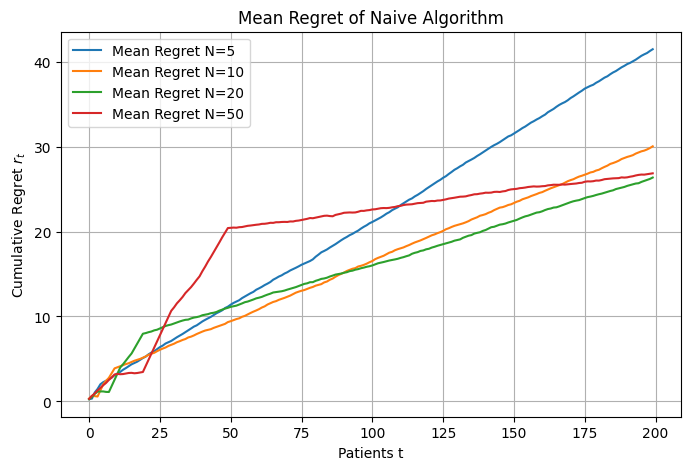

In [54]:
N = 10
K = 5
T = 200

def experiment_naive(N, K, T):
    all_regret = []
    n_exps = 200

    for _ in range(n_exps):

        rewards = naive(N, K, T)
        cumulative_reward = np.cumsum(rewards)
        regret_t = np.arange(1, T+1) * m_star - cumulative_reward

        all_regret.append(regret_t)

    mean_regret = np.mean(all_regret, axis=0)

    return mean_regret

plt.figure(figsize=(8,5))
plt.plot(experiment_naive(5, K, T), label="Mean Regret N=5")
plt.plot(experiment_naive(10, K, T), label="Mean Regret N=10")
plt.plot(experiment_naive(20, K, T), label="Mean Regret N=20")
plt.plot(experiment_naive(50, K, T), label="Mean Regret N=50")
plt.xlabel("Patients t")
plt.ylabel("Cumulative Regret $r_t$")
plt.title("Mean Regret of Naive Algorithm")
plt.legend()
plt.grid(True)
plt.show()

Dans ce graphique ci-dessus, on confirme bien que le choix de N a un impact important sur le regret cumulé. Pour N trop petit, on identifie mal le bras optimal et le regret reste élevé. Si N est trop grand, on gaspille trop de tirage et le regret initial est trop important (compensé à long terme).
Donc la valeur du regret dépend à la fois de N et de la durée totale T de l'expérience. 
On remarque donc les limites de l'algorithme naïf qui est sensible au choix des paramètres de départ. Une mauvaise calibration peut entraîner un regret élevé.

## Upper Confidence Bounds (P. Auer, 2002)

L'action $a_t$ l'instant $t$ est donnée par : 

$$a_t = max_a \left[ X_t(a) + B_t(a) \right]$$

où $X_t(a)$ est la moyenne empirique de la récompense obtenue avec le vaccin $a$ et $B_t(a)$ est un biais :

$B_t(a) = \sqrt{ \frac{2\log t}{T_a}}$ où $T_a$ est le nombre de fois que le vaccin $a$ a été choisi.

**Pourquoi cet algorithme n'a pas besoin d'une phase d'entraînement ? Quel terme favorise l'exploration et quel terme favorise l'exploitation ?**

Contrairement à l'algorithme naïf, UCB explore et exploite en même temps. La combinaison des deux termes pousse l'algorithme à essayer tous les bras. L'exploration est donc intégrée dynamiquement dans la règle de décision.

L'exploitation est favorisée par la moyenne empirique de la récompense $X_t(a)$ car cela pousse à rejouer les bras qui ont eu du succès.
L'exploration est favorisée par le biais $B_t(a)$ car moins le bras $a$ est tiré, plus il sera grand. Ainsi, il incite à essayer les bras incertains (peu tirés) afin de réduire l'incertitude.

**Implémentez l'algorithme et tracez l'évolution du regret à partir de cet algorithme.**

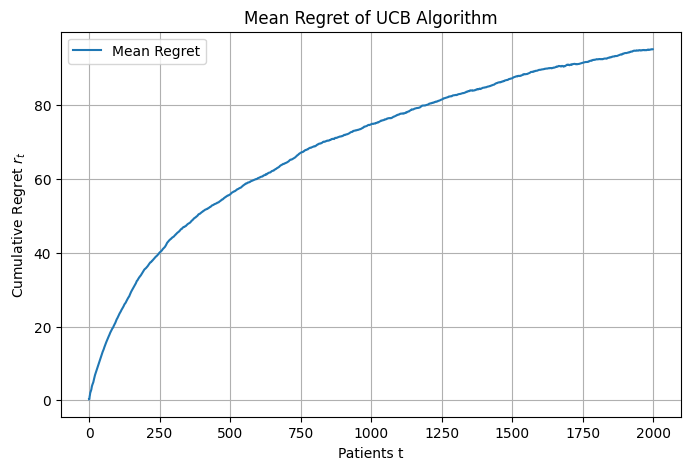

In [ ]:
K = 5
T = 2000
m_star = max(means)

def ucb(K, T, verbose=False):

    estimates = [0] * K
    counts = [0] * K
    rewards = []

    # For animation
    X_hist = np.zeros((T, K))
    B_hist = np.zeros((T, K))
    chosen_arm = np.zeros(T, dtype=int)

    for t in range(T):

        arm = np.argmax([estimate + np.sqrt(2 * np.log(t + 1) / c ) if c > 0 else float('inf')
                         for estimate, c in zip(estimates, counts)])
        reward = MAB[arm].sample()
        rewards.append(reward)
        counts[arm] += 1
        estimates[arm] += (reward - estimates[arm]) / counts[arm]

        # For animation
        X_hist[t, :] = estimates
        B_hist[t, :] = [np.sqrt(2 * np.log(t + 1) / c ) if c > 0 else 0.0 for c in counts]
        chosen_arm[t] = arm

    regret = T * m_star - np.sum(rewards)
    if verbose:
        print(f'The regret is : {regret}')

    return rewards, X_hist, B_hist, chosen_arm

def experiment_ucb(K, T):
    all_regret = []
    n_exps = 200

    for _ in range(n_exps):

        rewards, _, _, _ = ucb(K, T)
        cumulative_reward = np.cumsum(rewards)
        regret_t = np.arange(1, T+1) * m_star - cumulative_reward

        all_regret.append(regret_t)

    mean_regret = np.mean(all_regret, axis=0)

    return mean_regret

plt.figure(figsize=(8,5))
plt.plot(experiment_ucb(K, T), label="Mean Regret")
plt.xlabel("Patients t")
plt.ylabel("Cumulative Regret $r_t$")
plt.title("Mean Regret of UCB Algorithm")
plt.legend()
plt.grid(True)
plt.show()

**Créez une animation avec matplotlib qui permette de visualiser l'évolution des valeurs de $(X_a)_a$ et de $(B_a)_a$ au cours du temps**

Ici, c'est à vous de réfléchir à la meilleure représentation de ces valeurs.

In [70]:
from matplotlib.animation import FuncAnimation
from IPython.display import HTML, display

K = 5
T = 1000

def animate_bars(X_hist, B_hist, chosen_arm, means):
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10,4))

    bars_X = ax1.bar(range(K), X_hist[0], color="skyblue", edgecolor="black")
    for m in means:
        ax1.axhline(m, linestyle="--", linewidth=1, alpha=0.5)
    ax1.set_ylim(0, 1.05)
    ax1.set_xticks(range(K))
    ax1.set_xlabel("Arms")
    ax1.set_ylabel("$X_a$")
    ax1.set_title("$X_a(t)$")

    bars_B = ax2.bar(range(K), B_hist[0], color="lightgreen", edgecolor="black")
    ax2.set_ylim(0, np.max(B_hist) * 1.1)
    ax2.set_xticks(range(K))
    ax2.set_xlabel("Arms")
    ax2.set_ylabel("$B_a$")
    ax2.set_title("$B_a(t)$")

    txt = fig.text(0.5, 0.02, "", ha="center")

    def update(frame):
        for a, bar in enumerate(bars_X):
            bar.set_height(X_hist[frame, a])
            bar.set_color("skyblue")
        bars_X[chosen_arm[frame]].set_color("orange")

        for a, bar in enumerate(bars_B):
            bar.set_height(B_hist[frame, a])
            bar.set_color("lightgreen")
        bars_B[chosen_arm[frame]].set_color("orange")

        txt.set_text(f"t = {frame+1}, chosen arm = {chosen_arm[frame]}")
        return list(bars_X) + list(bars_B) + [txt]

    anim = FuncAnimation(fig, update, frames=T, interval=10, blit=False)
    plt.close(fig)
    return anim

rewards, X_hist, B_hist, chosen_arm = ucb(K, T)

anim = animate_bars(X_hist, B_hist, chosen_arm, means)

display(HTML(anim.to_jshtml()))

Animation size has reached 20999540 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


# Echantillonnage de Thomson

L'algorithme de Thompson calcule à chaque instant $t$ le paramètre des lois Beta pour tous les vaccins. Il échantillonne alors une probabilité de choisir chaque vaccin et choisit le vaccin avec la plus grande probabilité.

**Comment fonctionnent les lois Beta ? Comment les mettre à jour selon les résultats des vaccins ?**

Les lois Beta sont des distributions de probabilité définies sur l'intervalle [0, 1]. Elles sont paramétrées par deux valeurs, alpha et beta qui déterminent leur forme : alpha représente le nombre de succès observés et beta représente le nombre d’échecs observés.

Pour les mettre à jour avec les résultats des vaccins, si on observe s succès et e échecs, il suffit d'ajouter ces résultats aux paramètres initiaux tel que :

- alpha = alpha + s
- beta = beta + e

Dans notre cas, les paramètres sont initialisés à 1 et alpha est incrémenté si le vaccin choisi est un succès ou alors beta est incrémenté si celui-ci est un échec.

**Comment se passent l'exploration et l'exploitation ?**

Lors de l'exploration, les bras qui sont peu tirés ont une distribution Beta plus large (incertaine). Ces bras ont donc une chance d'être selectionnés même si la moyenne estimée n'est pas la meilleure.
Lors de l'exploitation, les bras souvent tirés et qui sont performants (comme le 1 dans notre cas), ont une distribution Beta étroite et centrée sur une valeur élevée. Ces bras sont donc favorisés.

À chaque étape, l’algorithme échantillonne une valeur pour chaque bras depuis sa distribution Beta et choisit celui avec la valeur la plus élevée. Ainsi, il explore naturellement les bras incertains et exploite ceux qui semblent optimaux, sans besoin de paramètre supplémentaire.

**Implémentez l'algorithme et tracez l'évolution du regret.**

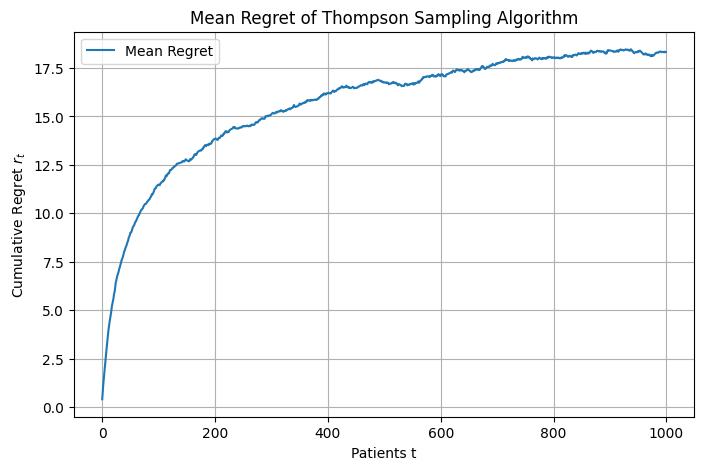

In [71]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML, display
from scipy.stats import beta

K = 5
T = 1000

def thompson_sampling(K, T):
    successes = np.ones(K)
    failures = np.ones(K)
    rewards = []

    # For animation
    alpha_hist = np.zeros((T, K))
    beta_hist = np.zeros((T, K))
    chosen_arm = np.zeros(T, dtype=int)

    for t in range(T):
        index = [beta.rvs(a + 1, b + 1) for a, b in zip(successes, failures)]
        arm = np.argmax(index)
        reward = MAB[arm].sample()
        rewards.append(reward)

        if reward == 1:
            successes[arm] += 1
        else:
            failures[arm] += 1

        alpha_hist[t, :] = successes
        beta_hist[t, :] = failures
        chosen_arm[t] = arm


    return rewards, alpha_hist, beta_hist, chosen_arm

def experiment_thompson_sampling(K, T):
    all_regret = []
    n_exps = 200

    for _ in range(n_exps):

        rewards, _, _, _ = thompson_sampling(K, T)
        cumulative_reward = np.cumsum(rewards)
        regret_t = np.arange(1, T+1) * m_star - cumulative_reward

        all_regret.append(regret_t)

    mean_regret = np.mean(all_regret, axis=0)

    return mean_regret

plt.figure(figsize=(8,5))
plt.plot(experiment_thompson_sampling(K, T), label="Mean Regret")
plt.xlabel("Patients t")
plt.ylabel("Cumulative Regret $r_t$")
plt.title("Mean Regret of Thompson Sampling Algorithm")
plt.legend()
plt.grid(True)
plt.show()

**Créez une animation avec matplotlib qui permette de visualiser l'évolution des probabilités au cours du temps**

Indice : pour représenter des probabilités, on pourra utiliser des diagrammes en violons.

In [80]:
K = 5
T = 1000

def animate_violin(alpha_hist, beta_hist, chosen_hist):

    fig, ax = plt.subplots(figsize=(8, 5))
    ax.set_ylim(0, 1)
    ax.set_xlim(-0.5, K - 0.5)
    ax.set_xticks(range(K))
    ax.set_xlabel("Arms")
    ax.set_ylabel("Probability Density")
    ax.set_title("Posterior Distributions (Thompson Sampling)")
    txt = fig.text(0.5, 0.02, "", ha="center")

    def update(frame):
        ax.cla()
        ax.set_ylim(0, 1)
        ax.set_xlim(-0.5, K - 0.5)
        ax.set_xticks(range(K))
        ax.set_xlabel("Arms")
        ax.set_ylabel("Probability Density")
        ax.set_title("Posterior Distributions (Thompson Sampling)")

        for a in range(K):
            data = np.random.beta(alpha_hist[frame, a], beta_hist[frame, a], 1000)
            parts = ax.violinplot(
                dataset=data,
                positions=[a],
                widths=0.8,
                showmeans=False,
                showextrema=False,
                showmedians=False
            )
            for pc in parts['bodies']:
                pc.set_facecolor('skyblue')
                pc.set_edgecolor('black')

        a_chosen = chosen_hist[frame]
        data = np.random.beta(alpha_hist[frame, a_chosen], beta_hist[frame, a_chosen], 1000)
        parts = ax.violinplot(
            dataset=data,
            positions=[a_chosen],
            widths=0.8,
            showmeans=False,
            showextrema=False,
            showmedians=False
        )
        for pc in parts['bodies']:
            pc.set_facecolor('orange')
            pc.set_edgecolor('black')

        txt.set_text(f"t = {frame+1}, chosen arm = {a_chosen}")
        return parts['bodies'], txt

    anim = FuncAnimation(fig, update, frames=T, interval=50, blit=False)
    plt.close(fig)
    return anim

rewards, alpha_hist, beta_hist, chosen_hist = thompson_sampling(K, T)
anim = animate_violin(alpha_hist, beta_hist, chosen_hist)
display(HTML(anim.to_jshtml()))

Animation size has reached 20984506 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.
